In [204]:
from shapely.geometry import Point
import pandas as pd
import geopandas as gpd
import os
import matplotlib.pyplot as plt
import numpy as np

# NavP and DR lat lon + std plots
NavP = navigation processor.
DR is probably a pre-decessor to NavP estimates.

In [205]:
cp_data_folder = '/media/li/LaCie/NBP2202/NBP2202_09/cp/Data'
navpos_file = os.path.join(cp_data_folder, 'navpos.txt')

In [206]:
nav_pos = pd.read_csv(navpos_file, delimiter='\t',
           names=['time',
                  'navlat', 'navlon', 'navlat_std', 'navlon_std',
                  'wp_lat_k', 'wp_lat_k1',
                  'drlat', 'drlon', 'drlat_std', 'drlon_std',
                 ],
           usecols=[0, 11, 12, 13, 14, 17, 19, 48, 49, 50, 51])

In [167]:
nav_pos.describe()

,time,navlat,navlon,navlat_std,navlon_std,wp_lat_k,wp_lat_k1,drlat,drlon,drlat_std,drlon_std
count,9.276600e+04,92766.000000,92766.000000,92766.000000,92766.000000,92766.000000,92766.000000,92766.000000,92766.000000,92766.000000,92766.000000
mean,1.644201e+09,-74.206052,-113.043467,86.029278,87.715479,-50.657051,-74.081070,-74.206298,-113.042533,671.789080,674.073196
std,2.678047e+04,0.050433,0.351863,107.521171,105.904545,34.532104,3.050726,0.050905,0.353653,1269.673757,1269.141502
min,1.644155e+09,-74.287118,-113.375744,2.146624,2.146598,-74.229485,-74.289058,-74.289065,-113.375738,2.147934,2.147909
25%,1.644178e+09,-74.223925,-113.275785,22.208637,26.592331,-74.211235,-74.229191,-74.223857,-113.275785,22.218795,26.601806
50%,1.644201e+09,-74.209725,-113.225603,27.487113,29.927912,-74.196065,-74.211235,-74.209705,-113.225603,27.494216,29.939346
75%,1.644224e+09,-74.198216,-112.871344,139.696190,140.013569,0.000000,-74.194187,-74.198162,-112.869656,378.577194,379.814774
max,1.644247e+09,-74.039141,-112.204640,293.510956,292.059021,0.000000,0.000000,-74.039141,-112.197434,4247.557129,4248.794922


In [184]:
%matplotlib inline
nav_pos.plot(x='time', y=['navlat_std', 'navlon_std', 'drlat_std', 'drlon_std'])

Using matplotlib backend: TkAgg


<AxesSubplot: xlabel='time'>

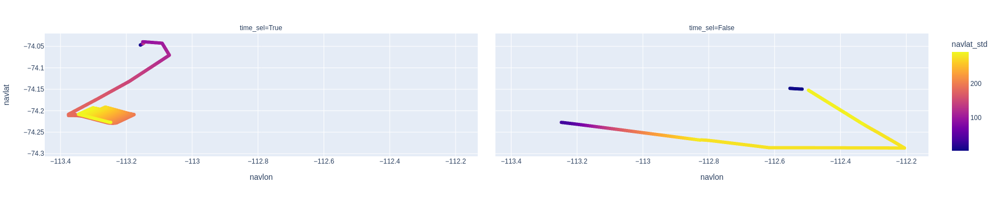

In [187]:
nav_pos['time_sel'] = False
nav_pos.loc[nav_pos['time'] < 1644218000, 'time_sel'] = True
px.scatter(nav_pos, y='navlat', x='navlon', color='navlat_std', facet_col='time_sel')

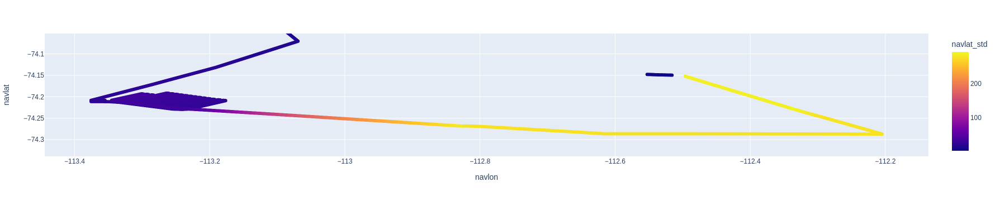

In [174]:
px.scatter(nav_pos, y='navlat', x='navlon', color='navlat_std')

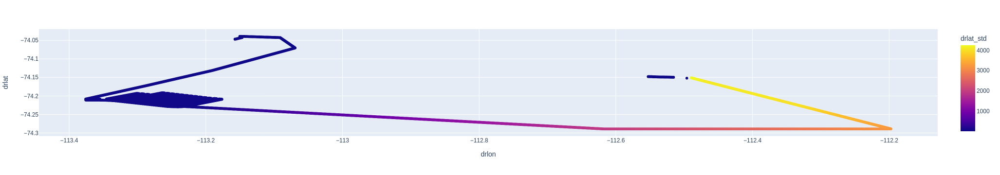

In [175]:
px.scatter(nav_pos, x='drlon', y='drlat', color='drlat_std')

# NavLab output plots

In [190]:
navlab_folder = '/media/li/LaCie/NBP2202/NBP2202_09/post'
pos_smooth_file = os.path.join(navlab_folder, 'position_smooth.txt')

In [199]:
pos_smooth = pd.read_csv(pos_smooth_file, delimiter=' ',
                        names=['time', 'lat_rad', 'lon_rad', 'depth_m'],
                        index_col=False)
pos_smooth.describe()

,time,lat_rad,lon_rad,depth_m
count,7.729330e+05,772933.000000,772933.000000,772933.000000
mean,1.644200e+09,-1.295192,-1.973015,348.206987
std,2.599274e+04,0.000887,0.005989,184.050452
min,1.644151e+09,-1.296567,-1.978779,-6.239565
25%,1.644177e+09,-1.295493,-1.976722,210.510814
50%,1.644200e+09,-1.295226,-1.976004,219.190706
75%,1.644222e+09,-1.295051,-1.971769,402.341511
max,1.644247e+09,-1.292227,-1.958333,800.345132


In [207]:
pos_smooth['lat_deg'] = np.rad2deg(pos_smooth['lat_rad'])
pos_smooth['lon_deg'] = np.rad2deg(pos_smooth['lon_rad'])